# Embeddings

## Librerías

In [7]:
import os
import json
import math
import time
import requests
import numpy as np
import pandas as pd
from tqdm import tqdm
from sklearn.decomposition import PCA

# Opcional: UMAP (mejor para estructura no lineal)
try:
    import umap
    _has_umap = True
except Exception:
    _has_umap = False

import plotly.express as px
import plotly.graph_objects as go


## Config

In [8]:
# ---------- CONFIG ----------
OLLAMA_URL = os.getenv("OLLAMA_URL", "http://localhost:11434/api/embed")
MODEL = os.getenv("OLLAMA_MODEL", "embeddinggemma:300m")
INPUT_CSV = "/home/jggomez/Desktop/IRIS/iris-uc3m/data/Base de datos Noticias 27102025.xlsx - Noticias_scrape.csv"       # <- cambia aquí al nombre de tu csv
OUTPUT_SUFFIX = "_embeddings.csv" # sufijo final
TEXT_COLUMN = "contenido_articulo"         # <- columna con el texto que quieres embeddings
EXPAND_DIMENSIONS = False         # True -> crea columnas emb_0 ... emb_N-1 (puede crear muchas columnas)
BATCH_SIZE = 8                    # número de peticiones por lote (ollama permite generalmente 1 por request, aquí se itera)
REQUEST_SLEEP = 0.0               # tiempo en segundos entre requests si quieres prevenir throttling
# -----------------------------


## Datos

In [9]:
# === 0. Leer datos y limpieza inicial ===
import pandas as pd
import numpy as np

df = pd.read_csv(INPUT_CSV)
print(f"🔹 Dataset original: {len(df)} filas, {len(df.columns)} columnas")

# --- 1. Verificar que existe la columna de texto principal ---
if TEXT_COLUMN not in df.columns:
    raise ValueError(f"No existe la columna textual '{TEXT_COLUMN}' en el CSV. Columnas disponibles: {list(df.columns)}")

# --- 2. Eliminar columnas completamente vacías ---
df = df.dropna(axis=1, how="all")

# --- 3. Convertir columna de texto a string, eliminar espacios y filtrar NaN/vacíos ---
df[TEXT_COLUMN] = df[TEXT_COLUMN].astype(str).str.strip()
df = df[df[TEXT_COLUMN].notna() & (df[TEXT_COLUMN] != "")]

# --- 4. Reemplazar strings vacíos o 'nan' literales por np.nan (por coherencia) ---
df = df.replace(["None", "none", "NaN", "nan", "NA", ""], np.nan)

# --- 5. Eliminar filas completamente vacías tras limpieza ---
df = df.dropna(how="all")

# --- 6. 🚨 Eliminar filas que contengan *cualquier* valor NaN ---
df = df.dropna(how="any")

# --- 7. Informe resumido ---
n_filas, n_cols = df.shape
n_nans = df.isna().sum().sum()
print(f"✅ Dataset limpio: {n_filas} filas, {n_cols} columnas (todas sin NaN)")
print(f"ℹ️ Celdas NaN restantes: {n_nans}")

# --- 8. Preparar lista de textos para embeddings ---
texts = df[TEXT_COLUMN].astype(str).tolist()

# Mostrar algunas filas como ejemplo
print("Ejemplo de textos limpios:")
print(df[TEXT_COLUMN].head(3).to_string(index=False))


🔹 Dataset original: 2106 filas, 44 columnas
✅ Dataset limpio: 1242 filas, 44 columnas (todas sin NaN)
ℹ️ Celdas NaN restantes: 0
Ejemplo de textos limpios:
Me disponía a escribir esta columna cuando reco...
Si se usan aplicaciones de citas tipo Tinder, G...
Taylor Swift es tendencia más allá de su música...


## Embeddings

In [10]:
LOAD_EMBEDDINGS = True

In [11]:
# === 1. Función para pedir embedding a Ollama ===
if not LOAD_EMBEDDINGS:
    def get_embedding_ollama(text, model=MODEL, url=OLLAMA_URL, timeout=30):
        """Pide embedding a Ollama para un único texto. Devuelve lista de floats."""
        payload = {"model": model, "input": text}
        try:
            r = requests.post(url, json=payload, timeout=timeout)
        except Exception as e:
            # fallo de conexión
            raise RuntimeError(f"Error conectando con Ollama: {e}")
        if r.status_code != 200:
            raise RuntimeError(f"Ollama returned status {r.status_code}: {r.text}")
        data = r.json()
        # Ollama suele devolver {"embedding": [...]} o similar
        if "embedding" in data:
            return data["embedding"]
        # Si la respuesta está anidada diferente:
        # buscar primer array de floats en data
        def find_first_array(obj):
            if isinstance(obj, list):
                if obj and isinstance(obj[0], (int, float)):
                    return obj
                for el in obj:
                    res = find_first_array(el)
                    if res is not None:
                        return res
            if isinstance(obj, dict):
                for v in obj.values():
                    res = find_first_array(v)
                    if res is not None:
                        return res
            return None
        emb = find_first_array(data)
        if emb is None:
            raise RuntimeError(f"No pude extraer embedding de la respuesta: {data}")
        return emb

In [12]:
# === 2. Batch loop con manejo de errores y tqdm ===
if not LOAD_EMBEDDINGS:
    embeddings = []
    errors = []
    for i, txt in enumerate(tqdm(texts, desc="Generando embeddings")):
        try:
            emb = get_embedding_ollama(txt)
            embeddings.append(emb)
        except Exception as e:
            # guardar error y continuar: se añade vector nulo del tamaño del primer embedding si ya existe, si no, None
            errors.append((i, str(e)))
            if embeddings:
                n = len(embeddings[0])
                embeddings.append([0.0]*n)
            else:
                embeddings.append(None)
        if REQUEST_SLEEP:
            time.sleep(REQUEST_SLEEP)

    # Manejo: si quedaron None, intentar de nuevo con texto vacío o con retry simple
    if any(e is None for e in embeddings):
        print("Algunos embeddings son None. Intentando rellenar con ceros de longitud detectada.")
        # detectar longitud
        lengths = [len(e) for e in embeddings if isinstance(e, list)]
        if lengths:
            L = max(lengths)
            embeddings = [ (e if isinstance(e, list) else [0.0]*L) for e in embeddings ]
        else:
            raise RuntimeError("No se pudo obtener ningún embedding válido. Revisa la conexión a Ollama y el modelo.")

    embeddings = np.array(embeddings)  # shape (N, D)
    print("Embeddings shape:", embeddings.shape)
    if errors:
        print(f"{len(errors)} errores (ejemplos):", errors[:5])


In [13]:
# Conteo de NaNs por columna (ordenado)
missing_counts = df.isna().sum().sort_values(ascending=False)
missing_counts[missing_counts > 0].head(40)


Series([], dtype: int64)

In [14]:
# === 3. Añadir embeddings al DataFrame ===
if not LOAD_EMBEDDINGS:
    # Guardamos la representación JSON en una columna 'embedding' (fácil de re-cargar)
    df = df.reset_index(drop=True)
    df["embedding"] = [json.dumps(list(map(float, e))) for e in embeddings]

    # Si quieres expandir a columnas emb_0..emb_{D-1}
    if EXPAND_DIMENSIONS:
        D = embeddings.shape[1]
        for dim in range(D):
            df[f"emb_{dim}"] = embeddings[:, dim]

In [15]:
# === 4. Guardar CSV con sufijo ===
if not LOAD_EMBEDDINGS:

    base, ext = os.path.splitext(INPUT_CSV)
    output_name = f"{base}{OUTPUT_SUFFIX}"
    df.to_csv(output_name, index=False)
    print(f"Guardado CSV con embeddings en: {output_name}")

In [23]:
# === 5. Cargar CSV con embeddings ===

if LOAD_EMBEDDINGS:
    # === 1️⃣ Load the CSV ===
    CSV_PATH = "/home/jggomez/Desktop/IRIS/iris-uc3m/data/Base de datos Noticias 27102025.xlsx - Noticias_scrape_embeddings.csv" 
    df = pd.read_csv(CSV_PATH)
    print(f"✅ Loaded {len(df)} rows, {len(df.columns)} columns")

    print(f"{df.columns=}")

    # === 2️⃣ Detect the embedding format ===
    if "embedding" in df.columns:
        print("Detected single 'embedding' column (JSON format). Decoding...")
        # Try parsing safely: handles strings like '[0.1, 0.2, ...]'
        def parse_embedding(x):
            if isinstance(x, str):
                try:
                    return json.loads(x)
                except json.JSONDecodeError:
                    try:
                        return ast.literal_eval(x)
                    except Exception:
                        return None
            elif isinstance(x, list):
                return x
            else:
                return None
        df["embedding_list"] = df["embedding"].apply(parse_embedding)
        # Filter out rows where parsing failed
        df = df[df["embedding_list"].notna()]
        # Convert to 2D numpy array
        embeddings = np.vstack(df["embedding_list"].values)
        print("✅ Embeddings loaded:", embeddings.shape)

    elif any(col.startswith("emb_") for col in df.columns):
        print("Detected separate emb_ columns.")
        emb_cols = [c for c in df.columns if c.startswith("emb_")]
        emb_cols = sorted(emb_cols, key=lambda x: int(x.split("_")[1]))  # sort numerically
        embeddings = df[emb_cols].to_numpy(dtype=np.float32)
        print("✅ Embeddings loaded:", embeddings.shape)

    else:
        raise ValueError("No embedding columns found in the CSV.")

    # === 3️⃣ Example: reuse embeddings for analysis ===
    # e.g. visualize again or compute UMAP/PCA
    print("Example first vector:", embeddings[0][:10])

    # Optional: check numeric validity
    if np.isnan(embeddings).any():
        print("⚠️ Warning: Some embeddings contain NaN values.")
    else:
        print("✅ All embedding values are numeric.")

✅ Loaded 1242 rows, 45 columns
df.columns=Index(['IdNoticia', 'NombreUsuario', 'Autor', 'MES', 'MMCC', 'Titular',
       'Contenido', 'Caracteres', 'Pagina', 'textonoticia',
       'Nombre propio titular', 'Cita titular', 'Género periodista',
       'nombre_periodista', 'Género personas noticias', 'Temática noticias',
       'IA principal', 'Significado IA', 'Referencias políticas igualdad',
       'Denuncia desigualdad género', 'Presencia mujeres racializadas',
       'Presencia  mujeres discapacidad', 'Presencia diversidad generacional',
       'Menciona IA', 'Lenguaje sexista', 'Masculino genérico',
       'Hombre humanidad', 'Uso dual zorra', 'No uso cargos mujeres',
       'Sexismo social', 'Androcentrismo_', 'Mujeres sin nombre',
       'Asimetría mujer hombre', 'Infantilización mujeres',
       'Denominación sexualizada', 'Denominación redundante',
       'Denominación dependiente', 'Criterios excepción',
       'Comparación mujeres/hombres', 'Tiene fotografía', 'Número fotograf

## Redución dimensionalidad

In [24]:
# === 5. Reducción de dimensionalidad (PCA) ===
pca = PCA(n_components=2)
pca_2 = pca.fit_transform(embeddings)
df["pca_1"] = pca_2[:,0]
df["pca_2"] = pca_2[:,1]
print("Varianza explicada por PCA (2 componentes):", pca.explained_variance_ratio_.sum())

Varianza explicada por PCA (2 componentes): 0.12227134251046279


In [25]:
# === 6. Alternativa UMAP (si está instalado) ===
use_umap = _has_umap
if use_umap:
    try:
        reducer = umap.UMAP(n_neighbors=15, min_dist=0.1, metric='cosine', random_state=42)
        umap_2 = reducer.fit_transform(embeddings)
        df["umap_1"], df["umap_2"] = umap_2[:,0], umap_2[:,1]
        print("UMAP completado.")
    except Exception as e:
        print("Fallo UMAP, se ignora:", e)
        use_umap = False

/home/jggomez/Desktop/IRIS/iris-uc3m/.venv/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


UMAP completado.


## Visualización

In [27]:
# visualizar_embeddings_dropdown_no_umap.py
import numpy as np
import pandas as pd
import re
import plotly.graph_objects as go
import plotly.express as px
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE

# ---------- CONFIG ----------
# Elige: "pca" (rápido) o "tsne" (más lento)
REDUCTION_METHOD = "pca"
# Si quieres forzar cálculo incluso si ya existen coords en df, pon True
FORCE_RECOMPUTE = False

MODEL_REDUCTION_PCA_NCOMP = 50  # para pre-PCA antes de TSNE
TSNE_PERPLEXITY = 30
TSNE_N_ITER = 1000
RANDOM_STATE = 42

# Rutas / nombres columnas
INPUT_CSV = "/home/jggomez/Desktop/IRIS/iris-uc3m/data/Base de datos Noticias 27102025.xlsx - Noticias_scrape_embeddings.csv"
TEXT_COLUMN = "contenido_articulo"
# --------------------------------

# --- helper: cargar df y embeddings si es necesario ---
df = pd.read_csv(INPUT_CSV)

# Si tienes una columna 'embedding' con listas stringificadas, convertir a matriz numpy
if "embedding" in df.columns and (not isinstance(df.loc[0, "embedding"], (list, np.ndarray))):
    def parse_list(x):
        try:
            return np.array(eval(x), dtype=float)
        except Exception:
            # fallback: strip brackets, split by comma
            s = str(x).strip("[]() ")
            if not s:
                return np.array([])
            return np.array([float(p) for p in s.split(",")], dtype=float)
    emb_list = df["embedding"].map(parse_list).tolist()
    embeddings = np.vstack([e if e.size else np.zeros(len(emb_list[0])) for e in emb_list])
# Si tienes variable `embeddings` ya disponible en el namespace, úsala
elif "embeddings" in globals():
    embeddings = globals()["embeddings"]
# Si hay columnas emb_0...emb_n
else:
    emb_cols = [c for c in df.columns if c.startswith("emb_")]
    if emb_cols:
        embeddings = df[emb_cols].values.astype(float)
    else:
        raise RuntimeError("No se encuentran embeddings (ni columna 'embedding' ni columnas 'emb_*' ni variable 'embeddings').")

# --- COMPUTAR COORDENADAS 2D SEGÚN REDUCTION_METHOD ---
if REDUCTION_METHOD.lower() == "pca":
    if FORCE_RECOMPUTE or ("pca_1" not in df.columns or "pca_2" not in df.columns):
        pca = PCA(n_components=2, random_state=RANDOM_STATE)
        coords = pca.fit_transform(embeddings)
        df["pca_1"], df["pca_2"] = coords[:,0], coords[:,1]
    x_col, y_col = "pca_1", "pca_2"
elif REDUCTION_METHOD.lower() == "tsne":
    if FORCE_RECOMPUTE or ("tsne_1" not in df.columns or "tsne_2" not in df.columns):
        # buena práctica: PCA previo a TSNE para velocidad/estabilidad
        n_pca = min(MODEL_REDUCTION_PCA_NCOMP, embeddings.shape[1])
        if n_pca < embeddings.shape[1]:
            pca_pre = PCA(n_components=n_pca, random_state=RANDOM_STATE)
            emb_for_tsne = pca_pre.fit_transform(embeddings)
        else:
            emb_for_tsne = embeddings
        tsne = TSNE(n_components=2, perplexity=TSNE_PERPLEXITY, n_iter=TSNE_N_ITER,
                    random_state=RANDOM_STATE, init="pca", metric="cosine")
        coords = tsne.fit_transform(emb_for_tsne)
        df["tsne_1"], df["tsne_2"] = coords[:,0], coords[:,1]
    x_col, y_col = "tsne_1", "tsne_2"
else:
    raise ValueError("REDUCTION_METHOD debe ser 'pca' o 'tsne'.")

# --- columnas candidatas para colorear (excluir coords/embeddings/text) ---
exclude = {"embedding", "pca_1","pca_2","tsne_1","tsne_2", x_col, y_col}
cols_for_color = [c for c in df.columns if c not in exclude and c != TEXT_COLUMN]

# limitar por seguridad
MAX_VARS_TO_SHOW = 80
cols_for_color = cols_for_color[:MAX_VARS_TO_SHOW]
if not cols_for_color:
    raise RuntimeError("No hay columnas disponibles para colorear.")

# --- util: preparar series para plot (numérico->float, categórico->codes) ---
def prepare_series_for_plot(series):
    s = series
    # devolver (values_array, is_categorical, display_strings_array)
    if pd.api.types.is_numeric_dtype(s):
        vals = s.astype(float).to_numpy()
        return vals, False, s.astype(str).to_numpy()
    codes, uniques = pd.factorize(s.astype(str))
    return codes, True, s.astype(str).to_numpy()

# --- elegir columna inicial que tenga datos válidos ---
initial_col = None
for c in cols_for_color:
    mask = df[c].notna() & df[x_col].notna() & df[y_col].notna()
    if mask.sum() > 0:
        initial_col = c
        break
if initial_col is None:
    raise RuntimeError("No hay filas válidas después de filtrar NaNs para ninguna columna candidata.")

# preparar arrays iniciales filtrando NaNs
mask_init = df[initial_col].notna() & df[x_col].notna() & df[y_col].notna()
x_init = df.loc[mask_init, x_col].to_numpy()
y_init = df.loc[mask_init, y_col].to_numpy()
color_vals_init, is_cat_init, text_vals_init = prepare_series_for_plot(df.loc[mask_init, initial_col])
hover_text_base = df.loc[mask_init, TEXT_COLUMN].astype(str).to_numpy()

# crear figura con traza inicial
fig = go.Figure()
fig.add_trace(go.Scattergl(
    x = x_init,
    y = y_init,
    mode = "markers",
    marker = dict(
        size = 7,
        opacity = 0.85,
        color = color_vals_init,
        colorscale = "Viridis",
        showscale = not is_cat_init
    ),
    text = hover_text_base,
    customdata = text_vals_init,
    hovertemplate = (
        "<b>%{text}</b><br><br>"
        f"{x_col}: %{{x:.3f}}<br>{y_col}: %{{y:.3f}}<br>"
        f"{initial_col}: %{{customdata}}<extra></extra>"
    ),
    name = initial_col
))

# construir botones dropdown para cada columna candidata
buttons = []
for col in cols_for_color:
    mask = df[col].notna() & df[x_col].notna() & df[y_col].notna()
    x = df.loc[mask, x_col].to_numpy().tolist()
    y = df.loc[mask, y_col].to_numpy().tolist()
    color_vals, is_cat, text_vals = prepare_series_for_plot(df.loc[mask, col])
    color_vals = color_vals.tolist()
    text_vals = df.loc[mask, col].astype(str).to_list()
    show_scale = (not is_cat)
    buttons.append(dict(
        label = col,
        method = "update",
        args = [
            {"x": [x],
             "y": [y],
             "marker.color": [color_vals],
             "marker.showscale": [show_scale],
             "customdata": [text_vals],
            #  "text": [df.loc[mask, TEXT_COLUMN].astype(str).to_list()]
            },
            {"title": f"Embeddings ({REDUCTION_METHOD.upper()}) coloreado por: {col}"}
        ]
    ))

fig.update_layout(
    updatemenus=[dict(
        buttons=buttons,
        active=cols_for_color.index(initial_col),
        x=0, xanchor="left",
        y=1.15, yanchor="top",
        showactive=True,
        direction="down"
    )],
    title=f"Embeddings reducidos con {REDUCTION_METHOD.upper()} - coloreado por: {initial_col}",
    width=950, height=650,
    margin=dict(l=10, r=10, t=100, b=10)
)

# hover genérico
fig.data[0].hovertemplate = (
    "<b>%{text}</b><br><br>"
    f"{x_col}: %{{x:.3f}}<br>{y_col}: %{{y:.3f}}<br>"
    "%{customdata}<extra></extra>"
)

fig.show()


✅ Using embeddings already in memory: (1242, 768)
✅ Analizando 25 variables presentes: ['Género periodista', 'Género personas noticias', 'IA principal', 'Significado IA', 'Referencias políticas igualdad', 'Denuncia desigualdad género', 'Presencia mujeres racializadas', 'Presencia  mujeres discapacidad', 'Presencia diversidad generacional', 'Menciona IA', 'Lenguaje sexista', 'Masculino genérico', 'Hombre humanidad', 'Uso dual zorra', 'No uso cargos mujeres', 'Sexismo social', 'Androcentrismo_', 'Mujeres sin nombre', 'Asimetría mujer hombre', 'Infantilización mujeres', 'Denominación sexualizada', 'Denominación redundante', 'Denominación dependiente', 'Criterios excepción', 'Comparación mujeres/hombres']


PCA listo: 50 componentes (var explicada total: 59.91%)
🏆 Ranking de separabilidad:


,variable,mean_H,max_H,best_dim,n_classes,n_samples
0,Género personas noticias,15.560842,99.726951,7,4,1242
1,IA principal,10.185896,205.229669,0,2,1242
2,Género periodista,9.934606,50.573288,3,5,1242
3,Androcentrismo_,6.548110,67.465906,2,2,1242
4,Denuncia desigualdad género,6.242138,32.946041,29,2,1242
5,Sexismo social,5.800633,64.887526,0,2,1242
6,Lenguaje sexista,5.294941,69.559332,2,3,1242
7,No uso cargos mujeres,4.487689,53.564560,0,2,1242
8,Denominación sexualizada,4.047759,39.474227,0,2,1242
9,Comparación mujeres/hombres,3.990250,26.909048,13,2,1242



=== Variable: Género personas noticias | PCA dim: 7 | mean_H=15.561 | classes=4 ===


/tmp/ipykernel_2572995/167147345.py:141: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(data_to_plot, labels=[str(c) for c in valid_classes], showfliers=False)


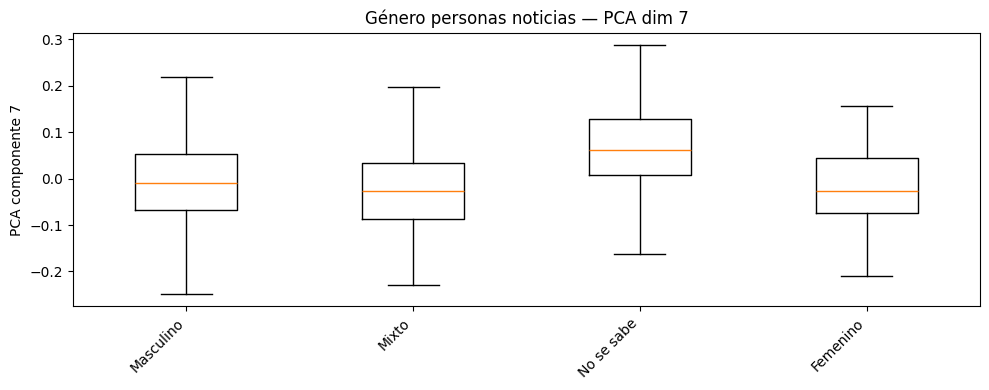

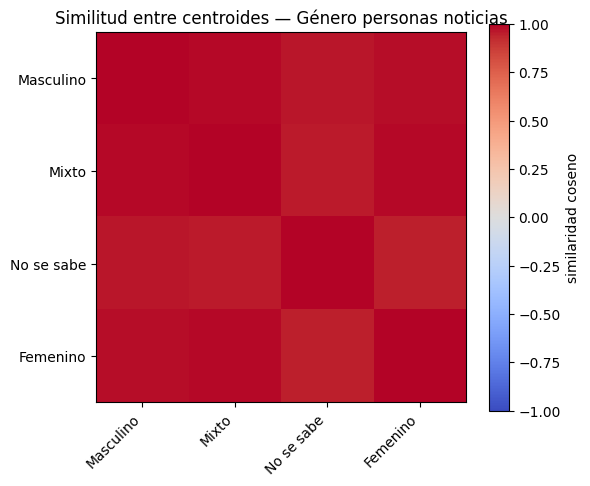

🔹 Pares más similares:
  Masculino — Mixto: 0.991
  Mixto — Femenino: 0.988
  Masculino — Femenino: 0.984
  Masculino — No se sabe: 0.966
  Mixto — No se sabe: 0.956
🔹 Pares más diferentes:
  Mixto — Femenino: 0.988
  Masculino — Femenino: 0.984
  Masculino — No se sabe: 0.966
  Mixto — No se sabe: 0.956
  No se sabe — Femenino: 0.946

=== Variable: IA principal | PCA dim: 0 | mean_H=10.186 | classes=2 ===


/tmp/ipykernel_2572995/167147345.py:141: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(data_to_plot, labels=[str(c) for c in valid_classes], showfliers=False)


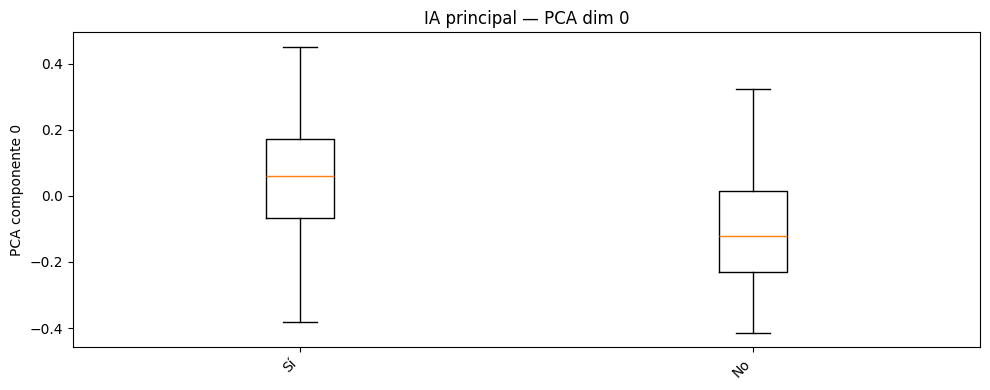

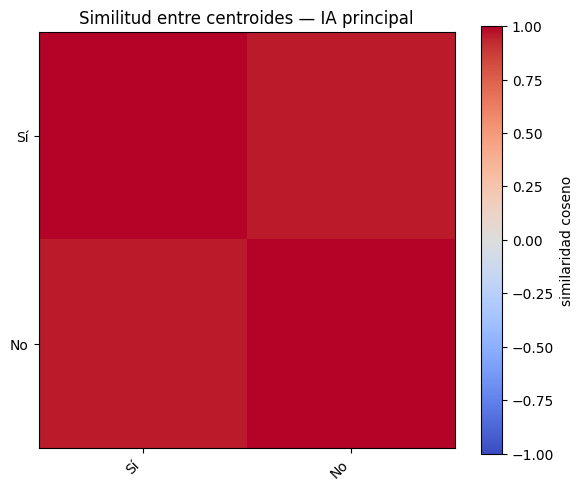

🔹 Pares más similares:
  Sí — No: 0.960
🔹 Pares más diferentes:
  Sí — No: 0.960

=== Variable: Género periodista | PCA dim: 3 | mean_H=9.935 | classes=5 ===


/tmp/ipykernel_2572995/167147345.py:141: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(data_to_plot, labels=[str(c) for c in valid_classes], showfliers=False)


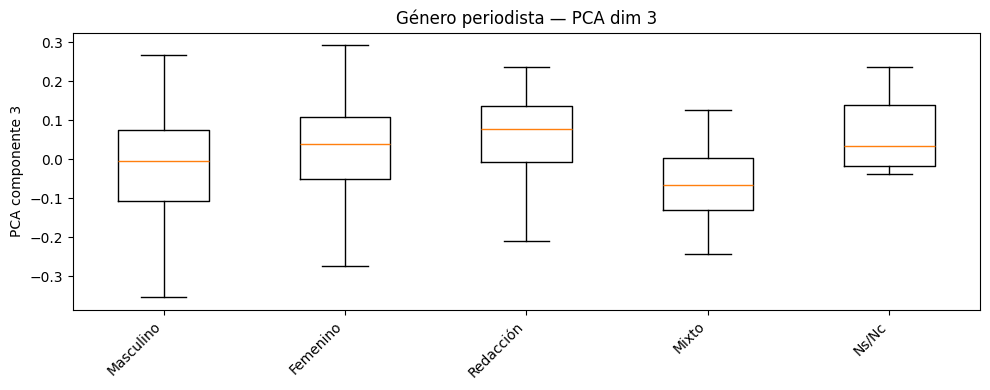

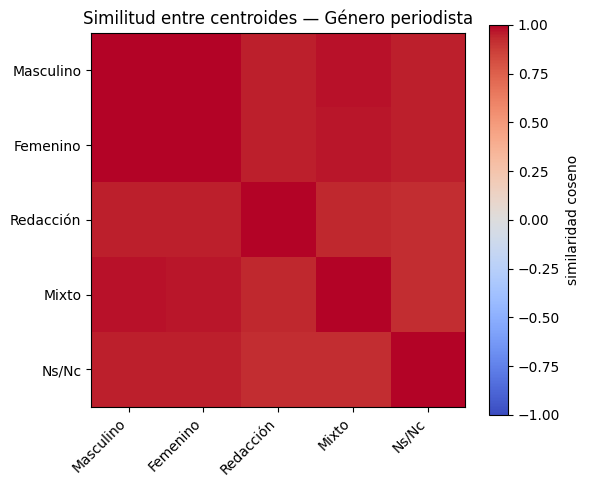

🔹 Pares más similares:
  Masculino — Femenino: 0.995
  Masculino — Mixto: 0.973
  Femenino — Mixto: 0.968
  Masculino — Redacción: 0.951
  Femenino — Redacción: 0.950
🔹 Pares más diferentes:
  Femenino — Ns/Nc: 0.949
  Masculino — Ns/Nc: 0.948
  Redacción — Mixto: 0.931
  Redacción — Ns/Nc: 0.921
  Mixto — Ns/Nc: 0.919

✅ Guardado ranking en 'variables_separability_ranking.csv'


In [26]:
# === ANALYSIS: separability by dimension (filtered variable set) ===
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from scipy.stats import kruskal
from sklearn.metrics.pairwise import cosine_similarity
import json, ast, os, itertools

# ---------- CONFIG ----------
INPUT_CSV = "/home/jggomez/Desktop/IRIS/iris-uc3m/data/Base de datos Noticias 27102025.xlsx - Noticias_scrape_embeddings.csv" 
TEXT_COLUMN = "contenido_articulo"
MIN_SAMPLES_PER_CLASS = 10            # mínimo de ejemplos por clase
MAX_PCA_DIM = 50                      # número máximo de componentes PCA a analizar
TOP_K = 3                             # cuántas variables visualizar
RANDOM_STATE = 42

# ---------- VARIABLES SELECCIONADAS ----------
TARGET_VARS = [
    "Género periodista",
    "Género personas noticias", "IA principal", "Significado IA",
    "Referencias políticas igualdad", "Denuncia desigualdad género",
    "Presencia mujeres racializadas", "Presencia  mujeres discapacidad",
    "Presencia diversidad generacional", "Menciona IA", "Lenguaje sexista",
    "Masculino genérico", "Hombre humanidad", "Uso dual zorra",
    "No uso cargos mujeres", "Sexismo social", "Androcentrismo_",
    "Mujeres sin nombre", "Asimetría mujer hombre", "Infantilización mujeres",
    "Denominación sexualizada", "Denominación redundante", "Denominación dependiente",
    "Criterios excepción", "Comparación mujeres/hombres"
]
# ------------------------------------------------

# --- 0) Load data and embeddings ---
if "embeddings" not in globals():
    df = pd.read_csv(INPUT_CSV)
    print(f"Loaded CSV: {INPUT_CSV} → {len(df)} rows")

    if "embedding" in df.columns:
        def parse_embedding(x):
            if isinstance(x, str):
                try:
                    return json.loads(x)
                except Exception:
                    try:
                        return ast.literal_eval(x)
                    except Exception:
                        return None
            elif isinstance(x, (list, np.ndarray)):
                return list(x)
            else:
                return None
        df["embedding_list"] = df["embedding"].apply(parse_embedding)
        df = df[df["embedding_list"].notna()].reset_index(drop=True)
        embeddings = np.vstack(df["embedding_list"].values)
        print("Embeddings loaded from 'embedding' column →", embeddings.shape)
    elif any(c.startswith("emb_") for c in df.columns):
        emb_cols = [c for c in df.columns if c.startswith("emb_")]
        emb_cols = sorted(emb_cols, key=lambda x: int(x.split("_")[1]))
        embeddings = df[emb_cols].to_numpy(dtype=float)
        print("Embeddings loaded from emb_* columns →", embeddings.shape)
    else:
        raise ValueError("No se encontraron embeddings en el CSV.")
else:
    print("✅ Using embeddings already in memory:", embeddings.shape)

# --- 1) Filtrar DataFrame por variables relevantes ---
vars_present = [v for v in TARGET_VARS if v in df.columns]
missing = [v for v in TARGET_VARS if v not in df.columns]
if missing:
    print(f"⚠️ Warning: Las siguientes variables no están en el dataset y serán ignoradas:\n{missing}")
if not vars_present:
    raise ValueError("Ninguna de las variables seleccionadas está presente en el dataset.")

df = df[vars_present + [TEXT_COLUMN]].copy()
print(f"✅ Analizando {len(vars_present)} variables presentes: {vars_present}")

# --- 2) PCA (reduce para interpretabilidad) ---
n_comp = min(MAX_PCA_DIM, embeddings.shape[1])
pca = PCA(n_components=n_comp, random_state=RANDOM_STATE)
pca_emb = pca.fit_transform(embeddings)
print(f"PCA listo: {n_comp} componentes (var explicada total: {pca.explained_variance_ratio_.sum():.2%})")

# --- 3) Cálculo separabilidad por variable ---
results = []
for var in vars_present:
    series = df[var]
    mask = series.notna()
    if mask.sum() < 2:
        continue
    y = series[mask]
    X = pca_emb[mask]

    counts = y.value_counts()
    valid_classes = counts[counts >= MIN_SAMPLES_PER_CLASS].index
    if len(valid_classes) < 2:
        continue

    groups_idx = [np.where(y == cls)[0] for cls in valid_classes]
    H_vals = []
    for dim in range(X.shape[1]):
        arrays = [X[idx, dim] for idx in groups_idx]
        try:
            H, p = kruskal(*arrays)
            H_vals.append(H)
        except Exception:
            H_vals.append(np.nan)

    H_vals = np.array(H_vals, dtype=float)
    results.append({
        "variable": var,
        "mean_H": np.nanmean(H_vals),
        "max_H": np.nanmax(H_vals),
        "best_dim": int(np.nanargmax(H_vals)),
        "n_classes": len(valid_classes),
        "n_samples": int(mask.sum())
    })

sep_df = pd.DataFrame(results).sort_values("mean_H", ascending=False).reset_index(drop=True)
if sep_df.empty:
    raise RuntimeError("No se encontraron variables con suficientes clases o muestras.")

print("🏆 Ranking de separabilidad:")
display(sep_df.head(10))

# --- 4) Visualización para las TOP-K variables ---
def plot_variable(var_row):
    var = var_row["variable"]
    best_dim = int(var_row["best_dim"])
    print(f"\n=== Variable: {var} | PCA dim: {best_dim} | mean_H={var_row['mean_H']:.3f} | classes={var_row['n_classes']} ===")
    s = df[var]
    mask = s.notna()
    counts = s[mask].value_counts()
    valid_classes = counts[counts >= MIN_SAMPLES_PER_CLASS].index
    mask2 = mask & s.isin(valid_classes)
    X = pca_emb[mask2]
    y = s[mask2].astype(str)

    # Boxplot de la dimensión más separadora
    plt.figure(figsize=(10,4))
    data_to_plot = [X[y == cls, best_dim] for cls in valid_classes]
    plt.boxplot(data_to_plot, labels=[str(c) for c in valid_classes], showfliers=False)
    plt.xticks(rotation=45, ha="right")
    plt.title(f"{var} — PCA dim {best_dim}")
    plt.ylabel(f"PCA componente {best_dim}")
    plt.tight_layout()
    plt.show()

    # Heatmap de similitud coseno entre centroides
    emb_masked = embeddings[mask2]
    centroids = []
    classes = []
    for cls in valid_classes:
        cls_mask = (y == cls)
        centroids.append(emb_masked[cls_mask.values].mean(axis=0))
        classes.append(str(cls))
    centroids = np.vstack(centroids)
    sim = cosine_similarity(centroids)
    plt.figure(figsize=(6,5))
    plt.imshow(sim, vmin=-1, vmax=1, cmap="coolwarm")
    plt.colorbar(label="similaridad coseno")
    plt.xticks(range(len(classes)), classes, rotation=45, ha="right")
    plt.yticks(range(len(classes)), classes)
    plt.title(f"Similitud entre centroides — {var}")
    plt.tight_layout()
    plt.show()

    # Mostrar las clases más y menos similares
    pairs = [(classes[i], classes[j], sim[i,j]) for i,j in itertools.combinations(range(len(classes)), 2)]
    pairs_sorted = sorted(pairs, key=lambda x: x[2], reverse=True)
    print("🔹 Pares más similares:")
    for a,b,score in pairs_sorted[:5]:
        print(f"  {a} — {b}: {score:.3f}")
    print("🔹 Pares más diferentes:")
    for a,b,score in pairs_sorted[-5:]:
        print(f"  {a} — {b}: {score:.3f}")

# --- 5) Ejecutar visualización para top-K ---
top_vars = sep_df.head(TOP_K).to_dict(orient="records")
for vr in top_vars:
    plot_variable(vr)

# --- 6) Guardar ranking ---
sep_df.to_csv("variables_separability_ranking.csv", index=False)
print("\n✅ Guardado ranking en 'variables_separability_ranking.csv'")
